$$
\newcommand{\mat}[1]{\boldsymbol {#1}}
\newcommand{\mattr}[1]{\boldsymbol {#1}^\top}
\newcommand{\matinv}[1]{\boldsymbol {#1}^{-1}}
\newcommand{\vec}[1]{\boldsymbol {#1}}
\newcommand{\vectr}[1]{\boldsymbol {#1}^\top}
\newcommand{\rvar}[1]{\mathrm {#1}}
\newcommand{\rvec}[1]{\boldsymbol{\mathrm{#1}}}
\newcommand{\diag}{\mathop{\mathrm {diag}}}
\newcommand{\set}[1]{\mathbb {#1}}
\newcommand{\norm}[1]{\left\lVert#1\right\rVert}
\newcommand{\pderiv}[2]{\frac{\partial #1}{\partial #2}}
\newcommand{\bb}[1]{\boldsymbol{#1}}
$$
# Part 6: YOLO - Objects Detection
<a id=part6></a>

In this part we will use an object detection architecture called YOLO (You only look once) to detect objects in images. We'll use an already trained model weights (v5) found here: https://github.com/ultralytics/yolov5

In [1]:
import torch

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

# Load the YOLO model
model = torch.hub.load("ultralytics/yolov5", "yolov5s")
model.to(device)
# Images
img1 = 'imgs/DolphinsInTheSky.jpg'  
img2 = 'imgs/cat-shiba-inu-2.jpg' 

cuda


Using cache found in /home/shay-lavi/.cache/torch/hub/ultralytics_yolov5_master


requirements: Ultralytics requirements ['gitpython>=3.1.30', 'urllib3>=2.5.0 ; python_version > "3.8"'] not found, attempting AutoUpdate...
WARNING ⚠️ Retry 1/2 failed: Command 'pip install --no-cache-dir "gitpython>=3.1.30" "urllib3>=2.5.0 ; python_version > "3.8"" ' returned non-zero exit status 2.
WARNING ⚠️ Retry 2/2 failed: Command 'pip install --no-cache-dir "gitpython>=3.1.30" "urllib3>=2.5.0 ; python_version > "3.8"" ' returned non-zero exit status 2.
WARNING ⚠️ requirements: ❌ Command 'pip install --no-cache-dir "gitpython>=3.1.30" "urllib3>=2.5.0 ; python_version > "3.8"" ' returned non-zero exit status 2.


YOLOv5 🚀 2025-12-17 Python-3.8.12 torch-1.10.1 CUDA:0 (NVIDIA GeForce RTX 2080 Ti, 11012MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


Adding AutoShape... 


## Inference with YOLO
<a id=part6_1></a>

You are provided with 2 images (img1 and img2).
**TODO**:
1. Detect objects using the YOLOv5 model for these 2 images.
2. Print the inference output with bounding boxes.
3. Look at the inference results and answer the question below.


In [9]:
print(model.names)

{0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell phone', 68: 'microw

inference output img 1:
image 1/1: 183x275 2 persons, 1 surfboard
Speed: 18.0ms pre-process, 26.5ms inference, 3.0ms NMS per image at shape (1, 3, 448, 640)
         xmin       ymin        xmax        ymax  confidence  class       name
0  100.278389  47.370995  187.863541  118.462646    0.903491      0     person
1   22.531378  20.887983  128.905197   92.257042    0.500974      0     person
2   85.618011  98.014702  139.018326  124.627907    0.367016     37  surfboard


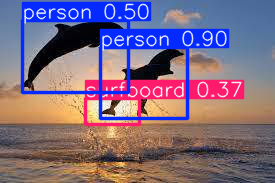

inference output img 2:
image 1/1: 750x750 2 cats, 1 dog
Speed: 19.5ms pre-process, 27.4ms inference, 2.0ms NMS per image at shape (1, 3, 640, 640)
         xmin        ymin        xmax        ymax  confidence  class name
0   11.568510  115.774994  312.757050  667.323608    0.655977     15  cat
1  363.715546  290.178497  750.000000  721.983887    0.509417     16  dog
2  311.190796  102.437439  595.031738  687.870728    0.391702     15  cat


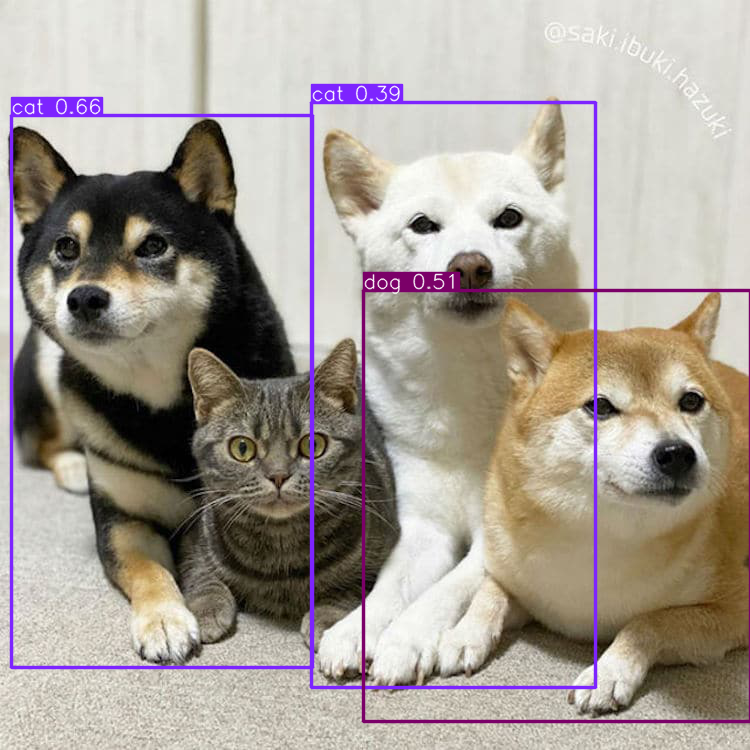

In [2]:
with torch.no_grad():
    #Detecting objects using YOLOv5
    objs_img1 = model(img1)
    objs_img2 = model(img2)

    #Printing inference output1 with bounding boxes
    print('inference output img 1:')
    print(objs_img1)
    print(objs_img1.pandas().xyxy[0])
    objs_img1.show()

    #Printing inference output2 with bounding boxes
    print('inference output img 2:')
    print(objs_img2)
    print(objs_img2.pandas().xyxy[0])
    objs_img2.show()

### Question 1

Analyze the inference results of the 2 images. 
1. How well did the model detect the objects in the pictures? with what confidance?
2. What can possibly be the reason for the model failures? suggest methods to resolve that issue.
3. recall that we learned how to fool a model by adverserial attack (PGD), describe how you would attack an Object Detection model (such as YOLO).

In [3]:
#====
from cs236781.answers import display_answer
import hw2.answers
#====

display_answer(hw2.answers.part6_q1)


**Your answer:**


Write your answer using **markdown** and $\LaTeX$:
```python
# A code block
a = 2
```
An equation: $e^{i\pi} -1 = 0$



## Creative Detection Failures

<a id=part6_2></a>

Object detection pitfalls could be, for example: **occlusion** - when the objects are partially occlude, and thus missing important features, **model bias** - when a model learn some bias about an object, it could recognize it as something else in a different setup, and many others like **Deformation**, **Illumination conditions**, **Cluttered** or **textured background and blurring** due to moving objects.

**TODO**: Take pictures and that demonstrates 3 of the above object detection pitfalls, run inference and analyze the results.

image 1/1: 729x684 1 person
Speed: 61.7ms pre-process, 18.1ms inference, 61.2ms NMS per image at shape (1, 3, 640, 608)
        xmin       ymin        xmax        ymax  confidence  class    name
0  30.689419  76.800339  505.526123  690.826294    0.404459      0  person


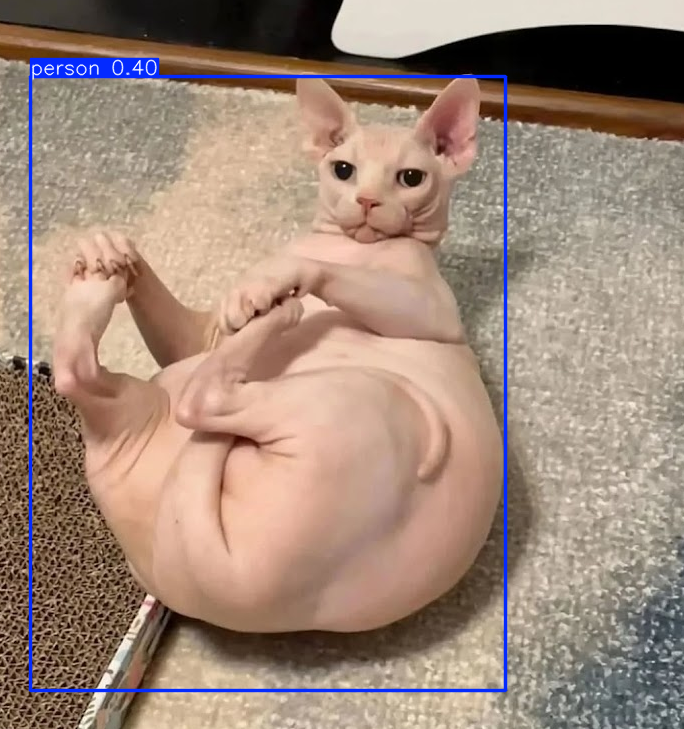

image 1/1: 4624x3468 1 cat
Speed: 508.3ms pre-process, 13.8ms inference, 1.7ms NMS per image at shape (1, 3, 640, 480)
         xmin       ymin         xmax         ymax  confidence  class name
0  105.291344  28.998447  3396.689209  2975.239014     0.29183     15  cat


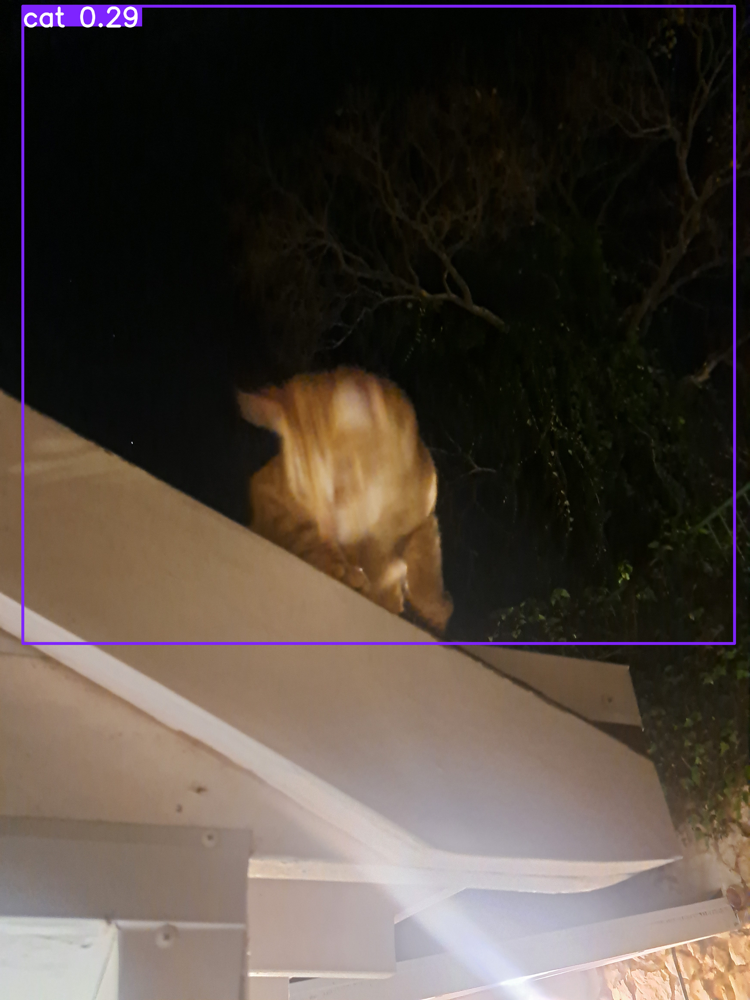

image 1/1: 870x1153 1 person
Speed: 140.4ms pre-process, 14.1ms inference, 1.7ms NMS per image at shape (1, 3, 512, 640)
       xmin       ymin        xmax        ymax  confidence  class    name
0  3.520986  21.355108  594.134399  865.547241    0.505721      0  person


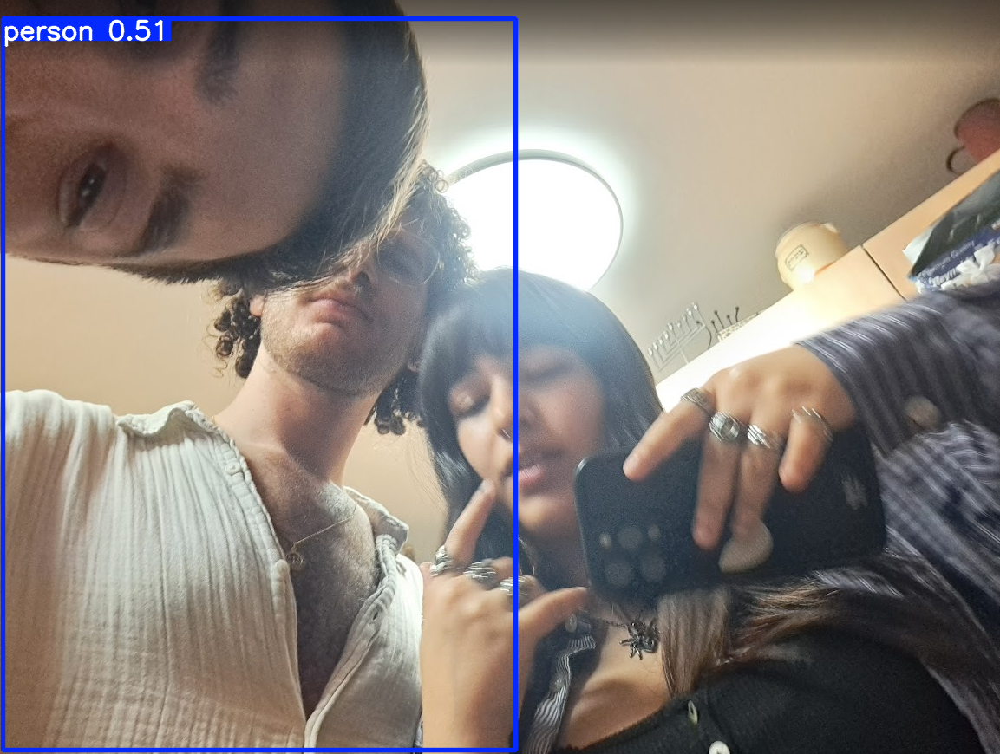

In [8]:
# You can change the images names in the code below, and add new ones
import glob

images = glob.glob("imgs/custom/*")

images = [
    "imgs/naked_cat.png",
    "imgs/night_cat.jpg",
    "imgs/selfie.png"
]

with torch.no_grad():
    for img in images:
        objs_img = model(img)
        print(objs_img)
        print(objs_img.pandas().xyxy[0])
        objs_img.show()

### Question 3

Analyize the results of the inference. 
1. How well did the model detect the objects in the pictures? explain.


In [13]:
display_answer(hw2.answers.part6_q3)



**Your answer:**


Write your answer using **markdown** and $\LaTeX$:
```python
# A code block
a = 2
```
An equation: $e^{i\pi} -1 = 0$



## Bonus 
<a id=part6_3></a>

Try improving the model performance over poorly recognized images by changing them. 
Describe the manipulations you did to the pictures.

In [6]:
import cv2

#insert bonus code here



In [7]:
display_answer(hw2.answers.part6_bonus)


**Your answer:**


Write your answer using **markdown** and $\LaTeX$:
```python
# A code block
a = 2
```
An equation: $e^{i\pi} -1 = 0$

